**Task: Use a local model to generate images for a fantasy themed card game deck**

# 1. Environment Set-up

1.1 Verify we are connected to the GPU




In [1]:
# Verify GPU availability
import torch
print("GPU available:", torch.cuda.is_available())
print("GPU Name:", torch.cuda.get_device_name(0))

GPU available: True
GPU Name: NVIDIA A100-SXM4-40GB


1.2 Install and import necessary libraries

In [3]:
!pip install diffusers transformers accelerate torch torchvision torchmetrics ftfy regex

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 119.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 87.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 57.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 9.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 36.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 15.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 2.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 96.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 960.9/960.9 kB 64.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.8/44.8 kB 4.4 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-c

In [4]:
!pip install git+https://github.com/openai/CLIP.git

  Cloning https://github.com/openai/CLIP.git to /tmp/pip-req-build-hx9b2sf8
  Running command git clone --filter=blob:none --quiet https://github.com/openai/CLIP.git /tmp/pip-req-build-hx9b2sf8
  Resolved https://github.com/openai/CLIP.git to commit dcba3cb2e2827b402d2701e7e1c7d9fed8a20ef1
  Preparing metadata (setup.py) ... done
  Created wheel for clip: filename=clip-1.0-py3-none-any.whl size=1369489 sha256=b1d8807b30031bea45091c11f8ddc4f0178e0aa71c8177558fdbb68b6dc43797
  Stored in directory: /tmp/pip-ephem-wheel-cache-vg377tdx/wheels/3f/7c/a4/9b490845988bf7a4db33674d52f709f088f64392063872eb9a
Successfully built clip


In [2]:
import pandas as pd
import torch
import clip
import os
from PIL import Image
import re
import numpy as np
from tqdm import tqdm
import time

In [3]:
# Used for Stable Diffusion and Open Journey
from diffusers import StableDiffusionPipeline
#Used for Dream Shaper
from diffusers import AutoPipelineForText2Image, DEISMultistepScheduler

1.3 Mount Google Drive to the notebook and create folders for the image outputs

In [4]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [5]:
#Set the paths for the folders to save images , replace with paths you would like to use for your own experiment
save_folder_stabdiff= "/content/drive/MyDrive/OutputImages/stabdiff"
save_folder_openjourney = "/content/drive/MyDrive/OutputImages/openjourney"
save_folder_DreamShaper = "/content/drive/MyDrive/OutputImages/DreamShaper"

#Make folders in our drive if they dont exist already
!mkdir -p "{save_folder_stabdiff}"
!mkdir -p "{save_folder_openjourney}"
!mkdir -p "{save_folder_DreamShaper}"


# 2. Data Collection

2.1 Define the scope of the card game

For our use case, we want to generate images for some cards for our fantasy themed card game deck. We first defined what categories of cards we wanted to cover and then specific items within these categories.

Characters: wizard, leprechaun, unicorn, fairy godmother

Monsters: goblin, dragon, trolls, snakes

Weapons: shield, sword, rope

Magic: bomb, lightning bolt, mystical hourglass, invisible cloak

Currency: pot of gold, ancient gold coin, diamond knecklace, ancient pocket watch

Environments: castle dinner party, enchanted forest, ancient ruins of fire

2.2 Define input text prompts for each "card" that will be used to generate images

In [6]:
#Create a dataframe of input text prompts for our dataset

fantasy_prompts_df = pd.DataFrame({
    "card_name": [
        "wizard", "leprechaun", "unicorn","fairy godmother", "goblin", "dragon", "trolls","snakes",
        "shield", "sword", "rope", "lightning_bolt","mystical hourglass","invisible cloak",
        "pot of gold", "ancient gold coin", "diamond knecklace", "ancient pocket watch",
        "castle dinner party", "enchanted forest", "ancient ruins of fire","magical clock tower"
    ],
    "detailed_prompt": [
        "A wizard casting a spell and laughing hysterically.",
        "A mischievous leprechaun guarding his pot of gold in an enchanted forest.",
        "Unicorn with a glowing horn running in a meadow with a rainbow in the background .",
        "Fairy godmother running through the gloomy forest, carrying a wand, casting a spell.",

        "Fierce goblin warrior with horns, a menacing expression and a sharp weapon in hand.",
        "Fire-breathing dragon soaring above the mountains at night with stars in the sky.",
        "Group of trolls lurking beneath a dark bridge, with red eyes and sharp teeth, eerie lighting.",
        "Two-headed snake slithering on a carpet, with black skin and hissing.",

        "Large shield glowing and shiny gold, with blue details.",
        "Ancient sword, with red details on the handle.",
        "Magical rope coiled up inside a chest and glowing with mystical energy.",

        "Powerful lightning bolt striking from stormy clouds onto the ground.",
        "Mystical hourglass sparkling and flowing in reverse,with a magical glow.",
        "All mighty invisibility cloak shimmering softly on a purple background.",

        "Pot overflowing with glittering gold coins, money and jewels.",
        "Ancient golden coin in a box, engraved with mystical symbols.",
        "Diamond necklace in a green jewelry box, shimmering in the light.",
        "Ancient pocket watch with glowing hands frozen in time.",

        "Lavish castle dinner party filled with nobles and knights and a wide spread of food and wine.",
        "Enchanted forest glowing with magical creatures, vibrant coloured flowers.",
        "Ancient ruins engulfed in mystical fire, detailed fiery effects in the background.",
        "Magical clock tower surrounded by tall oak trees and black crows.",
    ],
    "simple_prompt": [
        "Wizard casting spell",
        "Leprechaun with pot of gold",
        "Unicorn in meadow",
        "Fairy godmother running through forest",
        "Goblin warrior with sword",
        "Dragon breathing fire",
        "Trolls under a bridge",
        "Three-headed Snake",
        "Glowing magical shield",
        "Sword",
        "Magical rope coiled",
        "Lightning bolt striking from clouds",
        "Mystical hourglass with sand",
        "All mighty invisibility cloak",
        "Pot of gold chest",
        "Ancient golden coin",
        "Diamond necklace with jewels",
        "Ancient pocket watch",
        "Castle dinner party",
        "Enchanted magical forest",
        "Ruins with mystical fire",
        "Clock tower with temporal energy",
    ]
})

# Print DataFrame clearly
print(fantasy_prompts_df.head(15))

             card_name                                    detailed_prompt  \
0               wizard  A wizard casting a spell and laughing hysteric...   
1           leprechaun  A mischievous leprechaun guarding his pot of g...   
2              unicorn  Unicorn with a glowing horn running in a meado...   
3      fairy godmother  Fairy godmother running through the gloomy for...   
4               goblin  Fierce goblin warrior with horns, a menacing e...   
5               dragon  Fire-breathing dragon soaring above the mounta...   
6               trolls  Group of trolls lurking beneath a dark bridge,...   
7               snakes  Two-headed snake slithering on a carpet, with ...   
8               shield  Large shield glowing and shiny gold, with blue...   
9                sword     Ancient sword, with red details on the handle.   
10                rope  Magical rope coiled up inside a chest and glow...   
11      lightning_bolt  Powerful lightning bolt striking from stormy c...   

In [27]:
# add tag to open journey input prompts
openjourney_prompts = [prompt + ", mdjrny-v4 style" for prompt in fantasy_prompts_df["detailed_prompt"]]

# 3. Model Set Up

We selected three diffusion models to  compare for our experiment. Stable diffusion is the baseline model, open journey and dream shaper are two models that have been finetuned specifically for fantasy/artistic image generation using different methods.

3.1 Stable Diffusion Baseline

In [19]:
#Code from https://huggingface.co/stable-diffusion-v1-5/stable-diffusion-v1-5/tree/main

pipe_stabdiff = StableDiffusionPipeline.from_pretrained("sd-legacy/stable-diffusion-v1-5", torch_dtype=torch.float16)
pipe_stabdiff = pipe_stabdiff.to("cuda")

model_index.json:   0%|          | 0.00/541 [00:00<?, ?B/s]

Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.22G [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/308 [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/4.72k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/617 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/743 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/547 [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

3.2 Open journey

In [7]:
# Code from https://huggingface.co/prompthero/openjourney

pipe_openjourney = StableDiffusionPipeline.from_pretrained("prompthero/openjourney", torch_dtype=torch.float16)
pipe_openjourney = pipe_openjourney.to("cuda")

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

3.3 DreamShaper

In [33]:
#Code from https://huggingface.co/Lykon/dreamshaper-8

pipe_dreamshaper = AutoPipelineForText2Image.from_pretrained('lykon/dreamshaper-8', torch_dtype=torch.float16, variant="fp16")
pipe_dreamshaper = pipe_dreamshaper.to("cuda")

model_index.json:   0%|          | 0.00/642 [00:00<?, ?B/s]

Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

model.fp16.safetensors:   0%|          | 0.00/246M [00:00<?, ?B/s]

model.fp16.safetensors:   0%|          | 0.00/608M [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/614 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/796 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/724 [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/520 [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/167M [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/1.72G [00:00<?, ?B/s]

config.json:   0%|          | 0.00/1.87k [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/737 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/756 [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

/usr/local/lib/python3.11/dist-packages/transformers/models/clip/feature_extraction_clip.py:28: FutureWarning: The class CLIPFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use CLIPImageProcessor instead.
  warnings.warn(


# 4. Image Generation, Inference Time and GPU Memory Usage Calculations

In [30]:
# Function to generate and save images, and calculate the inference time and GPU used for each task
import torch
import time
import pandas as pd
import os

def generate_and_save_images(pipe, prompts, save_folder):
    """
    Generate images using a text-to-image model by inputting text prompts,
    and save the output images in a specified folder.

    Parameters:
    pipe: diffusers.DiffusionPipeline
        An instance of a text-to-image pipeline from the Hugging Face `diffusers` library.
    prompts : pd.Series or list of str
        A Pandas Series or list containing the text prompts used to generate images.
    save_folder: str
        Path to the folder where output images will be stored.
    """
    # Ensure the save folder exists
    os.makedirs(save_folder, exist_ok=True)

    results = []
    total_time = 0.0
    total_gpu_mem = 0.0

    for idx, prompt in enumerate(prompts):
        # Start measuring time and GPU memory
        torch.cuda.reset_peak_memory_stats()
        start_time = time.time()

        # Generate image
        image = pipe(prompt, num_inference_steps=25).images[0]

        # Measure generation time and GPU memory used
        generation_time = time.time() - start_time
        gpu_memory_used = torch.cuda.max_memory_allocated() / (1024**3)  # Convert bytes to GB

        # Update total statistics
        total_time += generation_time
        total_gpu_mem += gpu_memory_used

        # Save the generated image
        filename = os.path.join(save_folder, f"card_{idx+1}.png")
        image.save(filename)

        # Append result details
        results.append({
            'Prompt': prompt,
            'Filename': filename,
            'Generation Time (s)': generation_time,
            'GPU Memory Used (GB)': gpu_memory_used
        })

    # Calculate averages
    num_images = len(prompts)
    avg_time = total_time / num_images
    avg_gpu_mem = total_gpu_mem / num_images

    # Print summary
    print("\n**Benchmark Summary:**")
    print(f"Total Images Generated: {num_images}")
    print(f"Total Inference Time: {total_time:.2f} seconds")
    print(f"Total GPU Memory Usage: {total_gpu_mem:.2f} GB")
    print(f"Average Inference Time per Image: {avg_time:.2f} seconds")
    print(f"Average GPU Memory Used per Image: {avg_gpu_mem:.2f} GB")

    # Return results as a DataFrame
    return pd.DataFrame(results)


4.1 Stable Diffusion Image Generation

In [31]:
generate_and_save_images(pipe_stabdiff, fantasy_prompts_df["detailed_prompt"], save_folder_stabdiff)

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]


**Benchmark Summary:**
Total Images Generated: 22
Total Inference Time: 28.39 seconds
Total GPU Memory Usage: 127.72 GB
Average Inference Time per Image: 1.29 seconds
Average GPU Memory Used per Image: 5.81 GB


,Prompt,Filename,Generation Time (s),GPU Memory Used (GB)
0,A wizard casting a spell and laughing hysteric...,/content/drive/MyDrive/OutputImages/stabdiff/c...,1.272021,5.833592
1,A mischievous leprechaun guarding his pot of g...,/content/drive/MyDrive/OutputImages/stabdiff/c...,1.280614,5.804020
2,Unicorn with a glowing horn running in a meado...,/content/drive/MyDrive/OutputImages/stabdiff/c...,1.265147,5.804020
3,Fairy godmother running through the gloomy for...,/content/drive/MyDrive/OutputImages/stabdiff/c...,1.318755,5.804020
4,"Fierce goblin warrior with horns, a menacing e...",/content/drive/MyDrive/OutputImages/stabdiff/c...,1.323025,5.804020
5,Fire-breathing dragon soaring above the mounta...,/content/drive/MyDrive/OutputImages/stabdiff/c...,1.280607,5.804020
6,"Group of trolls lurking beneath a dark bridge,...",/content/drive/MyDrive/OutputImages/stabdiff/c...,1.297326,5.804020
7,"Two-headed snake slithering on a carpet, with ...",/content/drive/MyDrive/OutputImages/stabdiff/c...,1.346831,5.804020
8,"Large shield glowing and shiny gold, with blue...",/content/drive/MyDrive/OutputImages/stabdiff/c...,1.286845,5.804020
9,"Ancient sword, with red details on the handle.",/content/drive/MyDrive/OutputImages/stabdiff/c...,1.289366,5.804020


4.2 Open Journey Image Generation

In [32]:
generate_and_save_images(pipe_openjourney, openjourney_prompts, save_folder_openjourney)

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]


**Benchmark Summary:**
Total Images Generated: 22
Total Inference Time: 28.24 seconds
Total GPU Memory Usage: 127.69 GB
Average Inference Time per Image: 1.28 seconds
Average GPU Memory Used per Image: 5.80 GB


,Prompt,Filename,Generation Time (s),GPU Memory Used (GB)
0,A wizard casting a spell and laughing hysteric...,/content/drive/MyDrive/OutputImages/openjourne...,1.305627,5.804051
1,A mischievous leprechaun guarding his pot of g...,/content/drive/MyDrive/OutputImages/openjourne...,1.295014,5.804051
2,Unicorn with a glowing horn running in a meado...,/content/drive/MyDrive/OutputImages/openjourne...,1.295038,5.804051
3,Fairy godmother running through the gloomy for...,/content/drive/MyDrive/OutputImages/openjourne...,1.284825,5.804051
4,"Fierce goblin warrior with horns, a menacing e...",/content/drive/MyDrive/OutputImages/openjourne...,1.276131,5.804051
5,Fire-breathing dragon soaring above the mounta...,/content/drive/MyDrive/OutputImages/openjourne...,1.284434,5.804051
6,"Group of trolls lurking beneath a dark bridge,...",/content/drive/MyDrive/OutputImages/openjourne...,1.286915,5.804051
7,"Two-headed snake slithering on a carpet, with ...",/content/drive/MyDrive/OutputImages/openjourne...,1.287336,5.804051
8,"Large shield glowing and shiny gold, with blue...",/content/drive/MyDrive/OutputImages/openjourne...,1.280416,5.804051
9,"Ancient sword, with red details on the handle....",/content/drive/MyDrive/OutputImages/openjourne...,1.270987,5.804051


4.3 Dream Shaper Image Generation

In [34]:
generate_and_save_images(pipe_dreamshaper, fantasy_prompts_df["detailed_prompt"], save_folder_DreamShaper)

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]


**Benchmark Summary:**
Total Images Generated: 22
Total Inference Time: 27.86 seconds
Total GPU Memory Usage: 183.91 GB
Average Inference Time per Image: 1.27 seconds
Average GPU Memory Used per Image: 8.36 GB


,Prompt,Filename,Generation Time (s),GPU Memory Used (GB)
0,A wizard casting a spell and laughing hysteric...,/content/drive/MyDrive/OutputImages/DreamShape...,1.470582,8.359409
1,A mischievous leprechaun guarding his pot of g...,/content/drive/MyDrive/OutputImages/DreamShape...,1.257950,8.359409
2,Unicorn with a glowing horn running in a meado...,/content/drive/MyDrive/OutputImages/DreamShape...,1.255772,8.359409
3,Fairy godmother running through the gloomy for...,/content/drive/MyDrive/OutputImages/DreamShape...,1.242456,8.359409
4,"Fierce goblin warrior with horns, a menacing e...",/content/drive/MyDrive/OutputImages/DreamShape...,1.237041,8.359409
5,Fire-breathing dragon soaring above the mounta...,/content/drive/MyDrive/OutputImages/DreamShape...,1.257610,8.359409
6,"Group of trolls lurking beneath a dark bridge,...",/content/drive/MyDrive/OutputImages/DreamShape...,1.247776,8.359409
7,"Two-headed snake slithering on a carpet, with ...",/content/drive/MyDrive/OutputImages/DreamShape...,1.278730,8.359409
8,"Large shield glowing and shiny gold, with blue...",/content/drive/MyDrive/OutputImages/DreamShape...,1.282731,8.359409
9,"Ancient sword, with red details on the handle.",/content/drive/MyDrive/OutputImages/DreamShape...,1.288099,8.359409


# **5. Evaluation**

5.1 CLIP Evaluation

5.1.1 CLIP Evaluation Function

In [10]:
#Code from: https://lightning.ai/docs/torchmetrics/stable/multimodal/clip_score.html


def calculate_clip_similarity_batch(image_folder, prompts_df, prompt_column='prompt',
                                    index_offset=1, clip_model_name="ViT-L/14@336px", batch_size=4):
    """
    Calculate CLIP similarity between generataed images stored in a google driv folder and the input text prompts used to generate them

    Parameters:
    image_folder : str
        Path to folder containing images
    prompts_df : pandas.DataFrame
        DataFrame containing prompts
    prompt_column : str
        Name of the column in prompts_df that contains the prompts
    index_offset : int
        Offset between image numbers and DataFrame indices.
        If card_1.png corresponds to prompts_df.iloc[0], use index_offset=1
    clip_model_name : str
        Name of the CLIP model to use
    batch_size : int
        Batch size for processing images
    """
    # Load CLIP model
    device = "cuda" if torch.cuda.is_available() else "cpu"
    model, preprocess = clip.load(clip_model_name, device=device)

    # Get all image files
    image_files = [f for f in os.listdir(image_folder) if f.endswith(('.png', '.jpg', '.jpeg'))]

    # Extract image indices using regex
    pattern = r'.*?(\d+)\.(png|jpg|jpeg)$'
    image_df_indices = {}
    image_files_dict = {}

    for img_file in image_files:
        match = re.search(pattern, img_file)
        if match:
            img_number = int(match.group(1))
            df_index = img_number - index_offset  # Apply offset

            image_df_indices[img_number] = df_index
            image_files_dict[img_number] = img_file

    # Prepare results storage
    results = []

    # Process in batches
    img_numbers = list(image_files_dict.keys())
    batches = [img_numbers[i:i + batch_size] for i in range(0, len(img_numbers), batch_size)]

    for batch_img_numbers in tqdm(batches, desc="Processing images"):
        batch_images = []
        batch_prompts = []
        batch_img_files = []
        batch_numbers = []

        for img_number in batch_img_numbers:
            df_index = image_df_indices[img_number]

            # Skip if index not in DataFrame range
            if df_index < 0 or df_index >= len(prompts_df):
                print(f"Warning: Calculated index {df_index} for image {img_number} is out of DataFrame bounds")
                continue

            img_file = image_files_dict[img_number]
            img_path = os.path.join(image_folder, img_file)

            try:
                # Load and preprocess image
                image = preprocess(Image.open(img_path).convert("RGB")).unsqueeze(0)
                prompt = prompts_df.iloc[df_index][prompt_column]

                batch_images.append(image)
                batch_prompts.append(prompt)
                batch_img_files.append(img_file)
                batch_numbers.append(img_number)
            except Exception as e:
                print(f"Error processing {img_file}: {e}")

        if not batch_images:
            continue

        # Stack images and encode
        batch_images_tensor = torch.cat(batch_images).to(device)
        batch_prompts_tokens = clip.tokenize(batch_prompts).to(device)

        with torch.no_grad():
            # Encode images and text
            image_features = model.encode_image(batch_images_tensor)
            text_features = model.encode_text(batch_prompts_tokens)

            # Normalize features
            image_features = image_features / image_features.norm(dim=1, keepdim=True)
            text_features = text_features / text_features.norm(dim=1, keepdim=True)

            # Calculate similarities (cosine similarity)
            similarities = (1 * (image_features @ text_features.T)).diag().cpu().numpy()

        # Store results
        for img_file, img_number, prompt, similarity in zip(batch_img_files, batch_numbers, batch_prompts, similarities):
            df_index = image_df_indices[img_number]
            results.append({
                'image': img_file,
                'image_number': img_number,
                'df_index': df_index,
                'prompt': prompt,
                'similarity': similarity
            })

    # Convert to DataFrame
    results_df = pd.DataFrame(results)

    # Calculate statistics
    if len(results) > 0:
        avg_similarity = results_df['similarity'].mean()
        median_similarity = results_df['similarity'].median()
        min_similarity = results_df['similarity'].min()
        max_similarity = results_df['similarity'].max()
        std_similarity = results_df['similarity'].std()

        print(f"Average similarity: {avg_similarity:.2f}")
        print(f"Median similarity: {median_similarity:.2f}")
        print(f"Min similarity: {min_similarity:.2f}")
        print(f"Max similarity: {max_similarity:.2f}")
        print(f"Standard deviation: {std_similarity:.2f}")

    return results_df

5.1.2 CLIP Results Stable Diffusion

In [35]:
calculate_clip_similarity_batch(save_folder_stabdiff,fantasy_prompts_df,prompt_column="detailed_prompt")

Processing images: 100%|██████████| 6/6 [00:00<00:00,  9.86it/s]
/usr/local/lib/python3.11/dist-packages/pandas/io/formats/format.py:1458: RuntimeWarning: overflow encountered in cast
  has_large_values = (abs_vals > 1e6).any()


Average similarity: 0.29
Median similarity: 0.29
Min similarity: 0.15
Max similarity: 0.35
Standard deviation: 0.04


,image,image_number,df_index,prompt,similarity
0,card_1.png,1,0,A wizard casting a spell and laughing hysteric...,0.319336
1,card_2.png,2,1,A mischievous leprechaun guarding his pot of g...,0.314453
2,card_3.png,3,2,Unicorn with a glowing horn running in a meado...,0.271240
3,card_4.png,4,3,Fairy godmother running through the gloomy for...,0.287842
4,card_5.png,5,4,"Fierce goblin warrior with horns, a menacing e...",0.303955
5,card_6.png,6,5,Fire-breathing dragon soaring above the mounta...,0.295654
6,card_7.png,7,6,"Group of trolls lurking beneath a dark bridge,...",0.347412
7,card_8.png,8,7,"Two-headed snake slithering on a carpet, with ...",0.270264
8,card_9.png,9,8,"Large shield glowing and shiny gold, with blue...",0.281006
9,card_10.png,10,9,"Ancient sword, with red details on the handle.",0.273926


5.1.3 CLIP Results Open Journey

In [36]:
calculate_clip_similarity_batch(save_folder_openjourney,fantasy_prompts_df,prompt_column="detailed_prompt")

Processing images: 100%|██████████| 6/6 [00:00<00:00,  9.85it/s]

Average similarity: 0.28
Median similarity: 0.28
Min similarity: 0.22
Max similarity: 0.35
Standard deviation: 0.03



/usr/local/lib/python3.11/dist-packages/pandas/io/formats/format.py:1458: RuntimeWarning: overflow encountered in cast
  has_large_values = (abs_vals > 1e6).any()


,image,image_number,df_index,prompt,similarity
0,card_1.png,1,0,A wizard casting a spell and laughing hysteric...,0.285889
1,card_2.png,2,1,A mischievous leprechaun guarding his pot of g...,0.318359
2,card_3.png,3,2,Unicorn with a glowing horn running in a meado...,0.282959
3,card_4.png,4,3,Fairy godmother running through the gloomy for...,0.267822
4,card_5.png,5,4,"Fierce goblin warrior with horns, a menacing e...",0.296875
5,card_6.png,6,5,Fire-breathing dragon soaring above the mounta...,0.276367
6,card_7.png,7,6,"Group of trolls lurking beneath a dark bridge,...",0.299072
7,card_8.png,8,7,"Two-headed snake slithering on a carpet, with ...",0.293457
8,card_9.png,9,8,"Large shield glowing and shiny gold, with blue...",0.354248
9,card_10.png,10,9,"Ancient sword, with red details on the handle.",0.224976


5.1.4 CLIP Results Dream Shaper

In [37]:
calculate_clip_similarity_batch(save_folder_DreamShaper,fantasy_prompts_df,prompt_column="detailed_prompt")

Processing images: 100%|██████████| 6/6 [00:00<00:00,  9.82it/s]

Average similarity: 0.29
Median similarity: 0.29
Min similarity: 0.24
Max similarity: 0.36
Standard deviation: 0.03



/usr/local/lib/python3.11/dist-packages/pandas/io/formats/format.py:1458: RuntimeWarning: overflow encountered in cast
  has_large_values = (abs_vals > 1e6).any()


,image,image_number,df_index,prompt,similarity
0,card_1.png,1,0,A wizard casting a spell and laughing hysteric...,0.323242
1,card_2.png,2,1,A mischievous leprechaun guarding his pot of g...,0.307129
2,card_3.png,3,2,Unicorn with a glowing horn running in a meado...,0.274658
3,card_4.png,4,3,Fairy godmother running through the gloomy for...,0.305664
4,card_5.png,5,4,"Fierce goblin warrior with horns, a menacing e...",0.307617
5,card_6.png,6,5,Fire-breathing dragon soaring above the mounta...,0.281250
6,card_7.png,7,6,"Group of trolls lurking beneath a dark bridge,...",0.352295
7,card_8.png,8,7,"Two-headed snake slithering on a carpet, with ...",0.289062
8,card_9.png,9,8,"Large shield glowing and shiny gold, with blue...",0.311279
9,card_10.png,10,9,"Ancient sword, with red details on the handle.",0.261230


5.2 Human Evaluation

5.2.1 Sample Result Comparison

In [38]:
from IPython.display import display
from PIL import Image
import matplotlib.pyplot as plt
import os

# Define clearly your paths and model folders
base_folder = "/content/drive/MyDrive/OutputImages"

model_folders = {
    "Stable Diffusion": f"{save_folder_stabdiff}",
    "Openjourney": f"{save_folder_openjourney}",
    "DreamShaper": f"{save_folder_DreamShaper}"
}


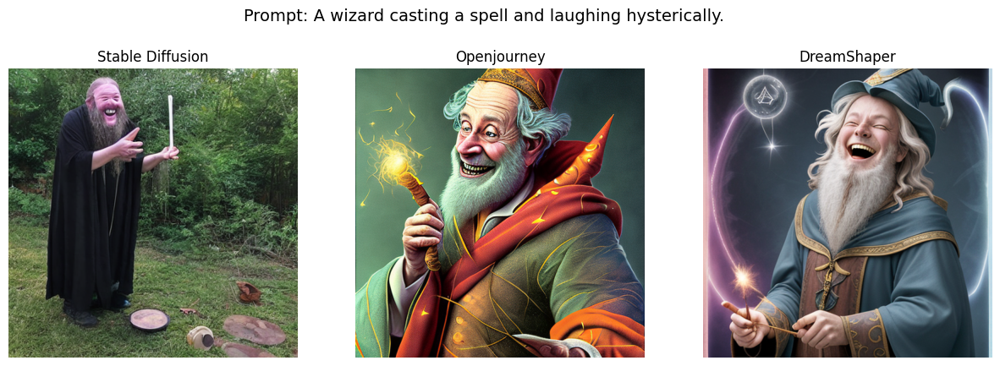

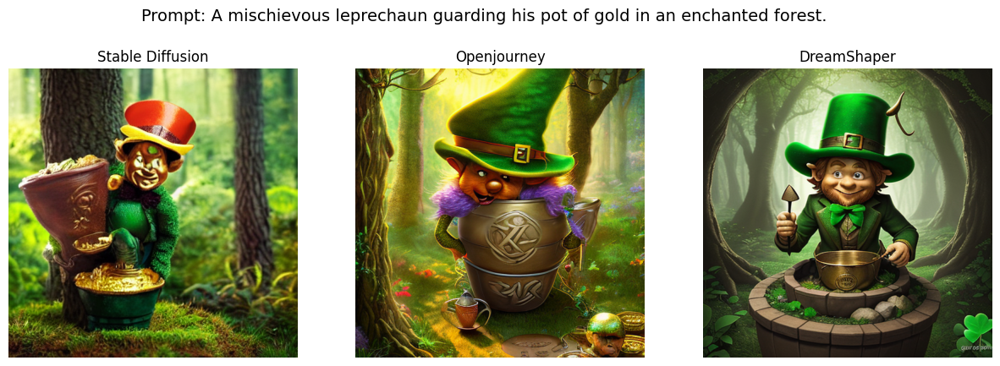

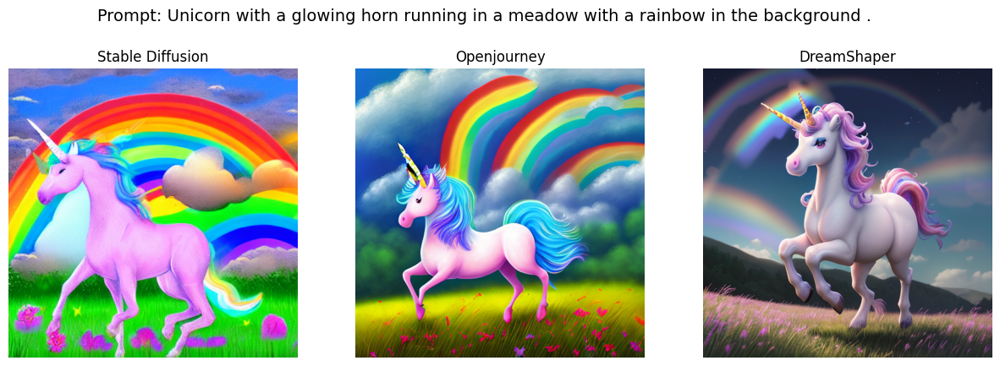

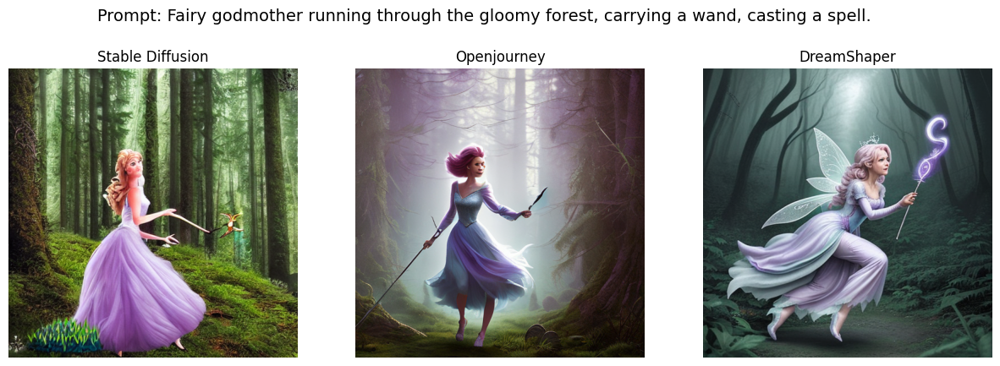

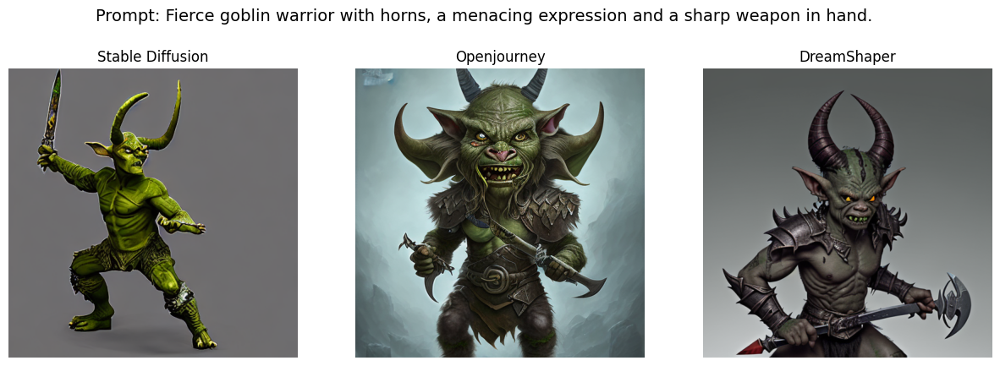

...

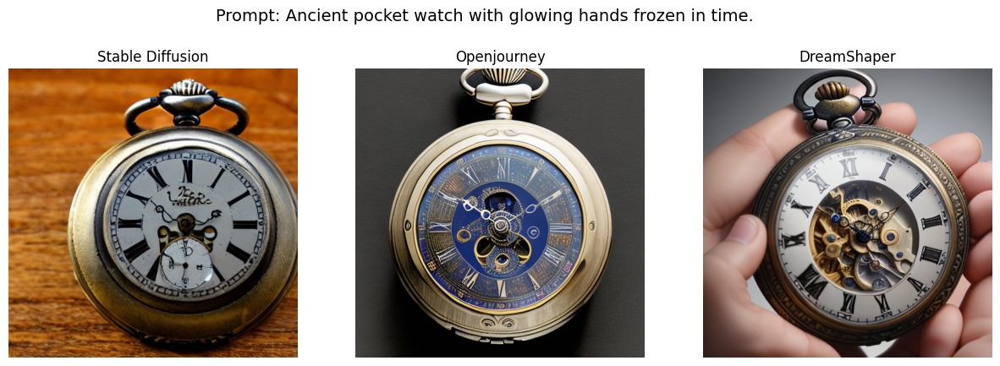

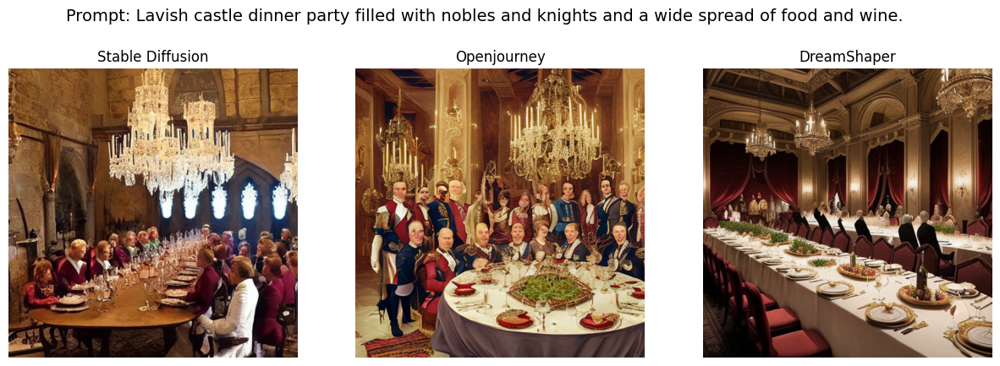

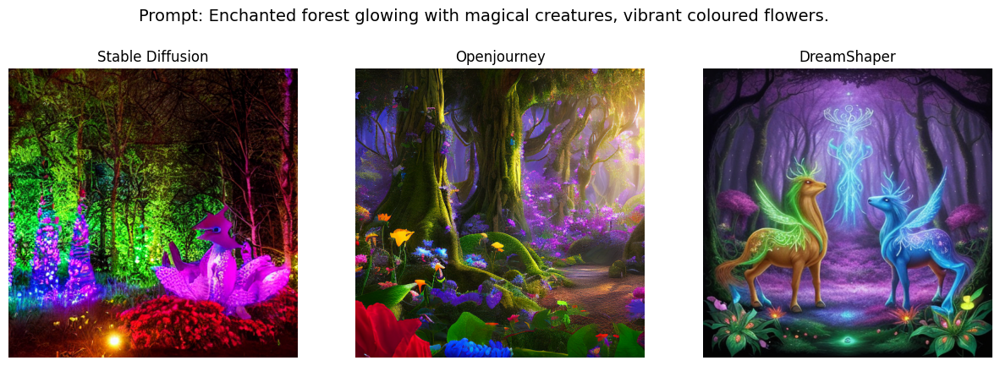

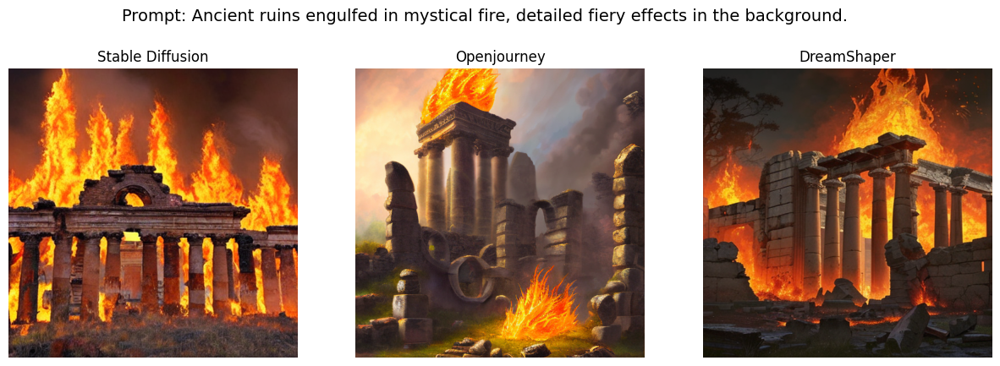

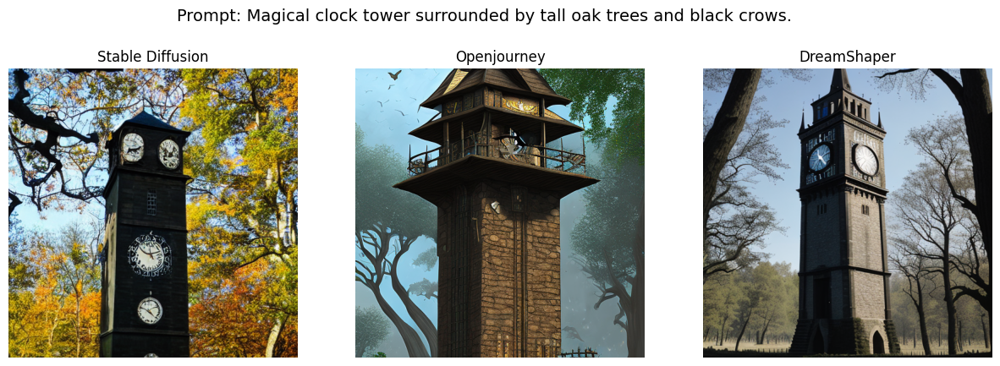

In [39]:
def display_images_side_by_side(model_folders, prompts):
  """
    Display generated images from each model side by side below the input text promt title used for generation

    Parameters:
    model_folders : dict
        Dictionary containing the model names and corresponding path to the folder containing generated images for that model
    prompts: list
      Column from the prompts dataframe containing input text used for generation
    """
  num_models = len(model_folders)
  num_prompts = len(prompts)

  for idx, prompt in enumerate(prompts):
      fig, axes = plt.subplots(1, len(model_folders), figsize=(5 * len(model_folders), 5))
      fig_title = f"Prompt: {prompt}"
      fig = plt.gcf()
      fig.suptitle(fig_title, fontsize=14)

      for i, (model_name, folder_path) in enumerate(model_folders.items()):
          image_path = os.path.join(folder_path, f"card_{idx+1}.png")
          image = Image.open(image_path)

          # Plot clearly side by side
          ax = plt.subplot(1, num_models, i+1)
          ax.imshow(image)
          ax.axis("off")
          ax.set_title(model_name, fontsize=12)

      plt.show()

# Clearly call the function to visualize images
display_images_side_by_side(model_folders, fantasy_prompts_df["detailed_prompt"])


5.2.2 Human Evaluation Scoring

The two aspects considered during the human evaluation of the output results for scoring were
1. Does the image contain all elements mentioned in the prompt ( Scale from 0-1) ?
2. The image's suitability for a fantasy card game deck






1. Scoring for Image Prompt Alignment

| Image Number | Stable Diffusion | Open Journey    | Dream Shaper   |
|--------------|------------------|-----------------|----------------|
| 1            | 1                | 0.75            | 1              |
| 2            | 1             | 1               | 1              |
| 3            | 1             | 1               | 1              |
| 4            | 0.75             | 0.75   |1  |
| 5            | 1     |1   |1    |
| 6            | 0.75     | 0.75   | 0.75   |
| 7            | 0.75     | 0.75   | 1    |
| 8            | 0.75     | 0.5   | 0.75    |
| 9            | 0.8     | 1   | 1    |
| 10           | 0.5     | 1  | 1    |
| 11           | 1     | 1   |1   |
| 12           | 1     | 1   |1  |
| 13           | 1     | 1   |1    |
| 14           | 0     | 0.25  | 1   |
| 15           | 0.5     | 0.75   | 0.75    |
| 16           | 1     | 1   |1    |
| 17           | 1     | 1   | 1    |
| 18           | 1     | 1   | 1   |
| 19           | 1    | 1   | 1  |
| 20           | 1     | 1   |1    |
| 21           | 1     | 1   |1    |
| 22           | 0.75     | 1   | 0.75   |
| Average      |  0.84  | 0.89   | 0.95   |




2. Scoring for Fantasy Card Game Suitability

After inspecting the output images, it is clear that the Dream Shaper Diffusion model shows the greatest suitability for generating images for a fanstasy themed card game deck out of the three models assessed.